
#NPL Fake News DataSet#

Lucas Jaenisch Lopes

In [149]:
!pip install tomotopy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#Initial Imports#

In [150]:
import sys
import spacy
import pandas as pd
import tomotopy as tp
import numpy as np
import gensim  
import re
from sklearn.feature_extraction.text import CountVectorizer
from google.colab import drive

spacy.cli.download("en_core_web_md")
nlp = spacy.load('en_core_web_md')

✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_md')


#Load Documents#

In [151]:
drive.mount('/content/drive')
fpath='/content/drive/MyDrive/'
df=pd.read_csv(fpath+'Fake.csv')
df.columns

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Index(['title', 'text', 'subject', 'date'], dtype='object')

In [152]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23481 entries, 0 to 23480
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    23481 non-null  object
 1   text     23481 non-null  object
 2   subject  23481 non-null  object
 3   date     23481 non-null  object
dtypes: object(4)
memory usage: 733.9+ KB


In [153]:
df.drop('subject', inplace=True, axis=1)
df.drop('date', inplace=True, axis=1)
df.drop('title', inplace=True, axis=1)

#NLP#

In [154]:
def get_average_feature_length(docs, feature):
  total_size = 0
  max_size = 0
  min_size = 999

  # print(docs)
  # print(feature)

  for i in docs:
    length = len(i)
    total_size += length
  
    if length > max_size:
      max_size = length

    if length < min_size:
      min_size = length

  print(f"\n{'-'*15} {feature} {'-'*15}")
  print(f"Average length: {int(total_size / len(docs))}")
  print(f"Max length: {max_size}")
  print(f"Min length: {min_size}")
  print(f"Total length (not unique): {total_size}")
  return int(total_size / len(docs))

avg_text_size = get_average_feature_length(df['text'], 'text')


--------------- text ---------------
Average length: 2547
Max length: 51794
Min length: 1
Total length (not unique): 59815411


#HTML to plain text#


In [ ]:
from bs4 import BeautifulSoup as soup

clean_text = []
r = len(df)

for f in df.columns:
  if f == 'text':
    for i in df[f][:r]:
      clean_text.append((soup(i, "lxml").text, len(i)))

In [156]:
new_text = []

for i in range(r):
  if not clean_text[i][1] > avg_text_size:
    new_text.append(clean_text[i][0])

In [ ]:
# df.head()

In [158]:
# Rejoin all remaining rows to the DataFrame
clean_df = pd.DataFrame()
clean_df['text'] = new_text

df = clean_df

#Stop Words#

In [159]:
spacy.cli.download("en_core_web_md")
nlp = spacy.load('en_core_web_md')

✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_md')


In [160]:
def convert_to_string(df, feature) -> str:
  output = []
  for i in range(len(df[feature])):
    output.append(df[feature][i].strip())
  return output

texts = convert_to_string(df, 'text')

dlemma = []
for i in texts:
  tdoc=nlp(i.lower())
  lm=" ".join([token.lemma_ for token in tdoc  if not(token.pos_ == 'NUM' or token.is_stop == True or token.is_digit == True or token.is_punct == True or token.lemma == False or token.like_email or  token.pos_ == 'VERB' or token.lemma_.startswith('@') or len(token.lemma_) < 3)])
  dlemma.append(lm)

for d1, d2 in zip(texts, dlemma):
  print(d1, '\n=>', d2)
  print()


House Intelligence Committee Chairman Devin Nunes is going to have a bad day. He s been under the assumption, like many of us, that the Christopher Steele-dossier was what prompted the Russia investigation so he s been lashing out at the Department of Justice and the FBI in order to protect Trump. As it happens, the dossier is not what started the investigation, according to documents obtained by the New York Times.Former Trump campaign adviser George Papadopoulos was drunk in a wine bar when he revealed knowledge of Russian opposition research on Hillary Clinton.On top of that, Papadopoulos wasn t just a covfefe boy for Trump, as his administration has alleged. He had a much larger role, but none so damning as being a drunken fool in a wine bar. Coffee boys  don t help to arrange a New York meeting between Trump and President Abdel Fattah el-Sisi of Egypt two months before the election. It was known before that the former aide set up meetings with world leaders for Trump, but team Tru

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




=> donald trump concerned terminally ill ability quality life pain happy sad november wednesday nevada rally trump terminally ill till november destruction united states sick donald doctor bad possible prognosis doesn till november trump naturally stephen colbert wasn unchecked thursday new campaign slogan donald trump terminally ill til election day diddy slogan vote stephen colbert october donald trump america literally people world him.while doubtful terminally ill november people sure sure president isn man sole concern vote matter from.featured image screengrab getty image ethan miller

Florida s Republican governor Rick Scott is not allowing the impending pressure of Hurricane Matthew to interrupt his partisan push on behalf of Donald Trump in his state. The storm is expected to disrupt day-to-day operations in the state at multiple levels, with multiple state and county agencies, as well as hundreds of private businesses, shutting down to ride out the weather event.The storm is

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




The racists came out in full force when Jimmy Kimmel put up a minute of video that is too outstanding to ignore. In a segment called,  The Hateful 8 Ball,  Kimmel gets advice from a mystical Samuel L Jackson inside a magic 8 ball toy. Jackson plays the part as you d expect, nailing the role of angry black man with iconic voice ever so perfectly.Definitely a great moment captured for all time   not only for a funny comedic piece, but as a historical record for the kind of racism that follows Donald Trump around. On hearing the name, the Trump trolls who keep this buffoon relevant enough that he might just win the GOP nomination hopped all over the comments on The Patriot Nation, the right-wing propaganda rag posting the video for other racists to be outraged at.This rocket doctor doesn t understand why racism has to be about race:When Bill Taylor, who went to Ball State University, says that President Obama had no qualifications other than he s black to run for president, that s it. Al

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
=> donald trump saturday woman bill clinton extramarital affair hillary clinton.trump response cuban row attempt debate dopey mark cuban benefactor fame row gennifer flower right alongside him!when hillary clinton podium monday night presidential debate old romantic rival row.gennifer flower year affair bill clinton attorney general governor arkansas debate hofstra university trump guest buzzfeed saturday flower donald debate personal assistant judy stell mail web site.the development twitter broadside trump early day dopey mark cuban benefactor fame row gennifer flower right alongside nyp

 
=> 

It s probably not a good time for Hillary to remind voters of her and Bill s coordinated war on women Donald Trump on Saturday threatened to bring a woman that Bill Clinton had an extramarital affair with when he debates Hillary Clinton.Trump tweeted this response to Mark Cuban sitting in the front row, in an attempt to rattle him during the 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)





In a lame effort to score political points for Hillary Clinton, the New York Times published a portion of Donald Trump s 1995 tax return. They re now promoting the idea that Trump  could have  not paid taxes for decades.  Could have  doesn t mean he did! Does anyone care that a man with a huge business empire might try and pay less taxes or work the tax system to his advantage? Isn t that what most people do and it s legal to do it! I would question Trump s sanity if he begged to pay more taxes! The front pages of the tax returns themselves are essentially a non-issue, representing the 1995 gross business loss incurred by candidate Donald Trump who operates a massive conglomeration of business entities.The anti-Trump political angle is easily identifiable within the extensive article use of:  could have ,  might be ,  may have , phrases used throughout the woven narrative. Journalistic  narratives  are rarely based on facts.The identified $916 million single year operating income los

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




=> fox news channel jeanine pirro gop establishment saturday justice pirro establishment republican leader democrats president loyalty effort president donald trump republican establishment commander chief day day country succession clear thing way pirro power damn later kumbaya crap big boy pant like power like damn importantly effort president united states breitbart

After allegedly registering 10,000 Muslims to take place in Germany s  March Against Terror,  the largest Muslim group in Germany refused to show because it would send the wrong message. Say what???A peace march organized by German Muslim groups to condemn terrorism and violence in the name of Islam has been held in Cologne. Organizers had registered 10,000 participants, but actual turnout was much lower.The liberal  The Independent  published a story about the 10,000 Muslims marching for peace before the march ever took place:10,000 Muslims to march against terrorism https://t.co/OC64Es1fRR #NichtMitUns #NotWithUs  Ar

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



lawless face behavior president regime able away simply lynch question complicated fact director comey law public everybody fact embarrassing presidential candidate fact necessarily question like good fact didn

Obama s war against cops and white people in full swing  Nobody s a winner in Obama s war on America March Eugene Ratney, according to Department of Correction records, wasn t due to be released from prison until this past June 6 after serving half of a 12-year sentence following his conviction as a serious violent felon with a weapon. Ten days later, Indianapolis Metropolitan Police Department (IMPD) officers were called to an east side address where Ratney s sister said he had pulled a gun and threatened to kill her.Investigators now report, and neighbors confirmed, Ratney, on parole, was the man clad in a Black Lives Matter t-shirt and screaming profanities at police, who shot up an IMPD officer s house not far from his own home early this morning.The officer and his family 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 
=> patrick wednesday independent talk kfnx current radio good news view analysis story domestically abroad week episode conspiracy year slew incredible story globally orlando nightclub mass shooting dallas cop shooting turkish coup white helmet podesta email fake news crisis one big conspiracy host patrick henningsen special guest shawn helton investigative journalist associate editor end download link download podcast end download program broadcast wednesday night mst right savage nation independent talk kfnx terrestrial band great phoenix central arizona region global satellite online interview patrick henningsen live archivesread conspiracy news 21st century wire conspiracy filessupport member

This year, let s try something a little different. Wherever you are Let s Make Christmas GREAT AGAIN  SEE MORE CHRISTMAS NEWS AT: 21st Century Wire Xmas Files 
=> year little different christmas great christmas news 21st century wire xmas file

Tune in to the Alternate Current Radio Network

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



#N grams#

In [161]:
from gensim.models.phrases import Phrases, Phraser

import gensim.utils

In [162]:
min_length = 4
dtoken = [gensim.utils.simple_preprocess(d, deacc=True, min_len=min_length) for d in dlemma]

for i in dtoken:
  if 'character' in i and 'offset' in i:
    print(i)
    
  # print(i)

bigram  = Phraser(Phrases(dtoken, min_count=5, threshold=15))
bdocs   = [bigram[d] for d in dtoken]


# [print(i) for i in bdocs]

In [163]:
print((bdocs)[:10])

[['house', 'intelligence_committee', 'chairman_devin', 'nunes', 'assumption', 'like', 'christopher_steele', 'dossier', 'russia_investigation', 'department_justice', 'order', 'trump', 'dossier', 'investigation', 'document', 'york', 'trump', 'campaign', 'adviser', 'george_papadopoulos', 'drunk', 'wine', 'knowledge', 'russian', 'opposition_research', 'hillary_clinton', 'papadopoulos', 'wasn', 'covfefe', 'trump', 'administration', 'large', 'role', 'damning', 'drunken', 'fool', 'wine', 'coffee', 'york', 'meeting', 'trump', 'president', 'abdel', 'fattah', 'sisi', 'egypt', 'month', 'election', 'aide', 'meeting', 'world_leader', 'trump', 'team', 'trump', 'merely', 'coffee', 'papadopoulos', 'australian', 'diplomat', 'alexander', 'downer', 'russian', 'official', 'possible', 'dirt', 'democratic_presidential', 'nominee', 'hillary_clinton', 'exactly', 'papadopoulos', 'night', 'kensington', 'wine', 'room', 'australian', 'alexander', 'downer', 'unclear', 'report', 'month', 'later', 'democratic', 'ema

In [164]:
bigrams = []

for i in bdocs:
  for j in i:
    bigrams.append(j)
    if '_' in j:
      print(j)

Streaming output truncated to the last 5000 lines.
secret_service
laptop_computer
hillary_clinton
national_security
secret_service
agent_vehicle
thursday_morning
agent_vehicle
secret_service
national_security
highly_sensitive
filessupport_work
tune_alternate
current_radio
network_live
broadcast_boiler
room_tonight
special_broadcast
uncensored_uninterruptible
talk_radio
custom_philosopher
misguided_moralist
masochist_street
corner_evangelist
medium_maniac
savant_political
animal_lovable
rascals_join
host_hesher
spore_funk
randy_stewart
wire_contributor
andy_nowicki
author_conspiracy
compliance_control
episode_boiler
water_plant
favorite_mead
horn_ready
deep_boiler
room_crew
tonight_gang
surprise_visit
presidential_nominee
john_mcafee
datum_dump
russian_hack
false_flag
listen_boiler
john_mcafee
spreaker_direct
download_episode
please_program
donate_page
involved_reference
century_wire
fake_news
john_mccain
rand_paul
stuart_hooper
john_mccain
fake_news
century_wire
fake_news
filessupport_

#Removing Dups#

In [222]:
bigramized = bigrams
uniques = set(bigramized)
uniques = dict(zip(range(len(uniques)), uniques))

print("Total bigrams: ", len(bigramized))
print("Unique bigrams: ",  len(uniques))

Total bigrams:  1493249
Unique bigrams:  48970


In [166]:
# uniques.values()

#Tokenize#

In [167]:
def tokenize(dlemma):
  max_size = len(dlemma); count = 0
  output = []
  
  for i in dlemma:
    # if count % 200 == 0:
      # print(f"{count}/{max_size}")
    
    aux = []; doc = nlp(i)

    for token in doc:
      if token.pos_ in ['NOUN', 'PROPN']:
        aux.append(token.lemma_)
    output.append(aux)
    count += 1
  return output
        
tokens = tokenize(uniques.values())
tokens[:10]

[['spotte'], [], [], [], [], [], ['entendre'], [], ['cockney'], ['giovanni']]

In [168]:
# remove empty objects from the tokens

print("Old number of Tokens: ", len(tokens))
clean_tokens = []
for t in tokens:
  if t != []:
    clean_tokens.append(t)
tokens = clean_tokens
print("New number of Tokens: ", len(tokens))

Old number of Tokens:  48970
New number of Tokens:  28460


In [169]:
# [print(d) for d in tokens]

#Statistics#

In [170]:
number_of_docs = len(tokens)
number_of_docs

28460

In [171]:
def stats_about_the_docs(docs, feature):
  total_size = 0
  max_size = 0
  min_size = 999

  for i in docs:
    length = len(i)
    total_size += length
  
    if length > max_size:
      max_size = length

    if length < min_size and length != 0:
      min_size = length
    
  print(f"{'-'*10} {feature} {'-'*10}")
  print(f"Average # of {feature}: {int(total_size / len(docs))}")
  print(f"Max # of {feature}: {max_size}")
  print(f"Min # of {feature}: {min_size}")

stats_about_the_docs(bdocs, 'text')

---------- text ----------
Average # of text: 78
Max # of text: 183
Min # of text: 1


#WordCloud#

In [172]:
def create_single_string(tokens):
  output = ''
  for i in tokens:
    for j in i:
      output += j + " "

  return output

output = create_single_string(tokens)
# output

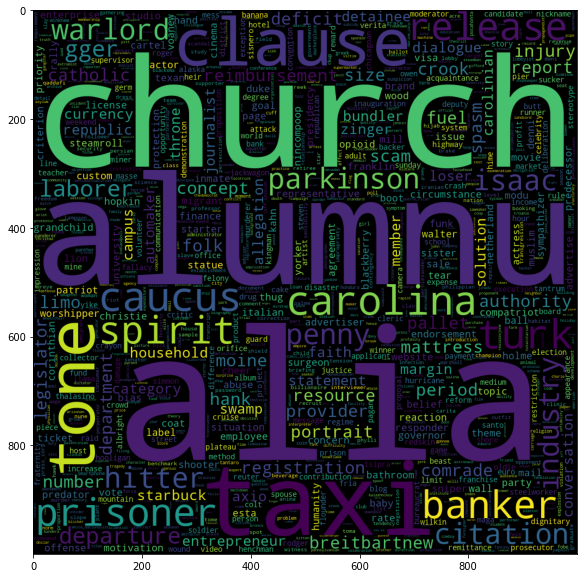

In [173]:
import wordcloud as wc
import matplotlib.pyplot as plt

mycloud = wc.WordCloud(max_words=1000,relative_scaling=1,width=1000,height=1000).generate(output)
plt.figure(figsize=(15,10))
plt.imshow(mycloud)

In [174]:
# [print(d) for d in bdocs]
# print(bdocs)
# print(collection)

In [175]:
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora import Dictionary
from gensim.models import LdaModel

#Bag of Words#

In [176]:
dictionary = Dictionary(bdocs)
dictionary.filter_extremes(keep_n = 10000, no_above= 0.8, no_below = len(bdocs)*.01)

corpus_bof=[dictionary.doc2bow(d) for d in bdocs]

#Hyper Parameters#

In [177]:
K=[20,25,30,35]
alpha=['symmetric']
eta=['symmetric']
passes=[100]
cv=[]
vocab = list(dictionary.values())
print('# of docs: %5d # of words: %6d'%(dictionary.num_docs, len(vocab)))
for k in K:
  for a in alpha:
    for b in eta:
      for p in passes:
        lda = LdaModel(corpus = corpus_bof,num_topics= k, random_state= 27644437, id2word = dictionary, alpha = a, eta=b,per_word_topics = True,passes = p)
        lda_cv = CoherenceModel(model=lda, texts= bdocs, dictionary=dictionary, coherence='c_v')
        cv_cohe=lda_cv.get_coherence()
        print('K: %2d alfa: %10s beta: %10s passes: %3d coherence: %.3f'%(k,a,b,p,cv_cohe))
        cv.append(cv_cohe)

# of docs: 14735 # of words:   1089
K: 20 alfa:  symmetric beta:  symmetric passes: 100 coherence: 0.466
K: 25 alfa:  symmetric beta:  symmetric passes: 100 coherence: 0.475
K: 30 alfa:  symmetric beta:  symmetric passes: 100 coherence: 0.465
K: 35 alfa:  symmetric beta:  symmetric passes: 100 coherence: 0.472


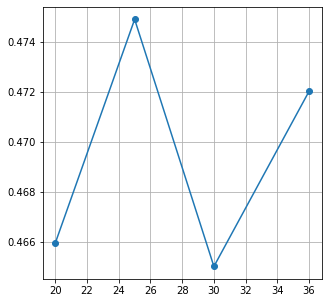

(0.47490105452116216, 25)


In [178]:
plt.figure(figsize=(5,5))
plt.plot((20,25,30,35),cv,marker='o')
plt.grid(True)
plt.show()
print(max(zip(cv,list(K))))

In [179]:
# print(dictionary)
vocab = list(dictionary.values())
# [print(v) for v in dictionary.values()]
# print('# of docs: %5d # of words: %6d'%(dictionary.num_docs, len(vocab)))

#Topics#

In [180]:
best_number_of_topics = 25

In [181]:
cv =[]
lda = LdaModel(corpus = corpus_bof,num_topics= best_number_of_topics, random_state= 27644437, id2word = dictionary, alpha ='symmetric', eta='symmetric',per_word_topics = True,passes = p)
lda_cv = CoherenceModel(model=lda, texts= bdocs, dictionary=dictionary, coherence='c_v')
cv_cohe=lda_cv.get_coherence()
print('K: %2d alfa: %10s beta: %10s passes: %3d coherence: %.3f'%(k,a,b,p,cv_cohe))
cv.append(cv_cohe)

K: 35 alfa:  symmetric beta:  symmetric passes: 100 coherence: 0.475


In [182]:
for i,d in enumerate(corpus_bof):
  print(bdocs[i],':',lda.get_document_topics(d,minimum_probability=0.4))

Streaming output truncated to the last 5000 lines.
['joni_ernst', 'conservative', 'excited', 'senate_seat', 'iowa', 'surprised', 'patriot', 'vote', 'below', 'bipartisan', 'congressional', 'trade', 'priority', 'accountability', 'vote', 'trade', 'promotion', 'authorityresult', 'cloture', 'motion', 'margin', 'vote', 'date', 'vote', 'june', 'time', 'vote', 'roll', 'number', 'vote', 'lamar', 'alexander', 'kelly_ayotte', 'john', 'barrasso', 'michael', 'bennet', 'blunt', 'john', 'boozman', 'richard_burr', 'maria', 'cantwell', 'shelley_moore', 'capito', 'thomas', 'carper', 'bill', 'cassidy', 'daniel', 'thad', 'cochran', 'christopher', 'coons', 'john_cornyn', 'cotton', 'michael', 'crapo', 'steve', 'michael', 'enzi', 'joni_ernst', 'dianne_feinstein', 'fischer', 'jeff_flake', 'cory_gardner', 'lindsey_graham', 'charles_grassley', 'orrin_hatch', 'heidi_heitkamp', 'dean_heller', 'john', 'hoeven', 'james', 'inhofe', 'johnny_isakson', 'johnson', 'kaine', 'mark', 'steven', 'kirk', 'james', 'lankford', 

In [183]:
tops=[]
for k in range(best_number_of_topics):
    t=[]
    for wt in lda.show_topic(k):
      t.append(wt[0])
    tops.append(t)
for t in tops:
  topic_coher=CoherenceModel(topics=[t], texts= bdocs, dictionary=dictionary, coherence='c_v')
  print('topic:',t)
  print('C_v:%.3f'%(topic_coher.get_coherence()))
print("All:")
topic_coher=CoherenceModel(topics=tops, texts= bdocs, dictionary=dictionary, coherence='c_v')
print('C_v:%.3f'%(topic_coher.get_coherence()))
# top topics
print('Topics with the highest coherence score the coherence for each topic.')
lda.top_topics(corpus=corpus_bof,dictionary=dictionary,coherence='c_v',texts=bdocs,topn=5)

topic: ['state', 'government', 'program', 'federal', 'judge', 'plan', 'cost', 'illegal', 'governor', 'right']
C_v:0.243
topic: ['current_radio', 'tune_alternate', 'broadcast_boiler', 'network_live', 'water', 'medium_maniac', 'mexico', 'host_hesher', 'wall', 'animal_lovable']
C_v:0.479
topic: ['syria', 'world', 'russia', 'government', 'united_states', 'iran', 'foreign_policy', 'american', 'country', 'deal']
C_v:0.399
topic: ['money', 'group', 'company', 'campaign', 'file', 'establishment', 'business', 'organization', 'ryan', 'bush']
C_v:0.090
topic: ['percent', 'number', 'year', 'poll', 'datum', 'secret_service', 'high', 'point', 'americans', 'people']
C_v:0.333
topic: ['speech', 'military', 'watch', 'isis', 'veteran', 'https_youtube', 'force', 'life', 'soldier', 'iraq']
C_v:0.189
topic: ['employee', 'player', 'worker', 'year', 'time', 'taxis', 'game', 'brother', 'team', 'company']
C_v:0.235
topic: ['woman', 'year', 'hollywood', 'lady', 'abortion', 'husband', 'bill_clinton', 'female', '

[([(0.07294103, 'hillary'),
   (0.07043494, 'clinton'),
   (0.058723453, 'hillary_clinton'),
   (0.056335814, 'election'),
   (0.04082061, 'candidate')],
  0.7755160930400742),
 ([(0.06973379, 'republican'),
   (0.057408746, 'republicans'),
   (0.047599424, 'bill'),
   (0.03858663, 'senator'),
   (0.0381572, 'senate')],
  0.7684001546693981),
 ([(0.033792473, 'clinton'),
   (0.029912725, 'email'),
   (0.029103732, 'investigation'),
   (0.022105847, 'information'),
   (0.019860048, 'hillary_clinton')],
  0.7450502862389048),
 ([(0.048761014, 'police'),
   (0.021165796, 'city'),
   (0.018759407, 'officer'),
   (0.014538806, 'year'),
   (0.0127547, 'police_officer')],
  0.7420886900061425),
 ([(0.11251484, 'black'),
   (0.09074952, 'white'),
   (0.07128815, 'student'),
   (0.053261947, 'school'),
   (0.046621088, 'racist')],
  0.730298800027902),
 ([(0.14050099, 'twitter'),
   (0.053655934, 'tweet'),
   (0.052135292, 'https'),
   (0.035308328, 'july'),
   (0.029928194, 'photo')],
  0.7066

#Hottest Topics#

[22, 12, 14, 16, 10, 1, 13, 21, 2, 24]


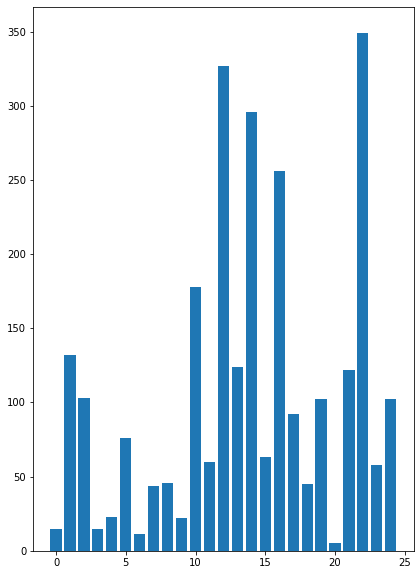

In [184]:
plt.figure(figsize=(15,10))
tops_frequency=[0]*best_number_of_topics
tops_f=[0]*25
x=0

for d in corpus_bof:
  aux=lda.get_document_topics(d,minimum_probability=0.4)
  if aux!=[]:
    tops_frequency[aux[0][0]]+=1
plt.subplot(1, 2, 1)
plt.bar(range(best_number_of_topics),tops_frequency)

for i in range(best_number_of_topics):
  aux1=[tops_frequency[i],i]
  tops_frequency[i]=aux1
tops_frequency.sort()
tops_frequency.reverse()
# print(tops_frequency)

aux2=[0]*10
for i in range(10):
  aux2[i]=tops_frequency[i][1]
print(aux2)
plt.show()

In [185]:
for i in aux2:
  print(lda.show_topics(num_topics=best_number_of_topics)[i])

(22, '0.049*"police" + 0.021*"city" + 0.019*"officer" + 0.015*"year" + 0.013*"police_officer" + 0.012*"victim" + 0.012*"black_life" + 0.012*"time" + 0.011*"news" + 0.011*"incident"')
(12, '0.034*"clinton" + 0.030*"email" + 0.029*"investigation" + 0.022*"information" + 0.020*"hillary_clinton" + 0.019*"official" + 0.016*"document" + 0.013*"state_department" + 0.013*"news" + 0.013*"government"')
(14, '0.286*"trump" + 0.066*"donald_trump" + 0.023*"president" + 0.014*"campaign" + 0.014*"image" + 0.013*"like" + 0.012*"time" + 0.010*"thing" + 0.010*"people" + 0.009*"fact"')
(16, '0.075*"people" + 0.035*"like" + 0.030*"thing" + 0.023*"right" + 0.018*"image" + 0.018*"good" + 0.015*"time" + 0.014*"fact" + 0.013*"doesn" + 0.012*"actually"')
(10, '0.118*"trump" + 0.110*"president" + 0.066*"white_house" + 0.027*"administration" + 0.021*"donald_trump" + 0.015*"press" + 0.015*"meeting" + 0.014*"washington" + 0.013*"reporter" + 0.010*"news"')
(1, '0.063*"current_radio" + 0.063*"tune_alternate" + 0.063

#Labeling#

In [186]:
ddd=[]
for j in aux2:
  ddd2=[]
  for i,d in enumerate(corpus_bof):
    if len(ddd)<10:
      aux=lda.get_document_topics(d,minimum_probability=0.5)
    else:
      aux=lda.get_document_topics(d,minimum_probability=0.3)
    if aux!=[]:
      if aux[0][0]==j:
        ddd2.append(i)
        # print(aux[0],':',i,bdocs[i])
  ddd.append(ddd2)

In [187]:
for i in ddd:
  print(len(i),end=" ")

350 326 300 258 179 132 123 122 100 100 

In [188]:
df.head()

,text
0,"House Intelligence Committee Chairman Devin Nunes is going to have a bad day. He s been under the assumption, like many of us, that the Christopher Steele-dossier was what prompted the Russia investigation so he s been lashing out at the Department of Justice and the FBI in order to protect Trump. As it happens, the dossier is not what started the investigation, according to documents obtained by the New York Times.Former Trump campaign adviser George Papadopoulos was drunk in a wine bar when he revealed knowledge of Russian opposition research on Hillary Clinton.On top of that, Papadopoulos wasn t just a covfefe boy for Trump, as his administration has alleged. He had a much larger role, but none so damning as being a drunken fool in a wine bar. Coffee boys don t help to arrange a New York meeting between Trump and President Abdel Fattah el-Sisi of Egypt two months before the election. It was known before that the former aide set up meetings with world leaders for Trump, but team Trump ran with him being merely a coffee boy.In May 2016, Papadopoulos revealed to Australian diplomat Alexander Downer that Russian officials were shopping around possible dirt on then-Democratic presidential nominee Hillary Clinton. Exactly how much Mr. Papadopoulos said that night at the Kensington Wine Rooms with the Australian, Alexander Downer, is unclear, the report states. But two months later, when leaked Democratic emails began appearing online, Australian officials passed the information about Mr. Papadopoulos to their American counterparts, according to four current and former American and foreign officials with direct knowledge of the Australians role. Papadopoulos pleaded guilty to lying to the F.B.I. and is now a cooperating witness with Special Counsel Robert Mueller s team.This isn t a presidency. It s a badly scripted reality TV show.Photo by Win McNamee/Getty Images."
1,"Pope Francis used his annual Christmas Day message to rebuke Donald Trump without even mentioning his name. The Pope delivered his message just days after members of the United Nations condemned Trump s move to recognize Jerusalem as the capital of Israel. The Pontiff prayed on Monday for the peaceful coexistence of two states within mutually agreed and internationally recognized borders. We see Jesus in the children of the Middle East who continue to suffer because of growing tensions between Israelis and Palestinians, Francis said. On this festive day, let us ask the Lord for peace for Jerusalem and for all the Holy Land. Let us pray that the will to resume dialogue may prevail between the parties and that a negotiated solution can finally be reached. The Pope went on to plead for acceptance of refugees who have been forced from their homes, and that is an issue Trump continues to fight against. Francis used Jesus for which there was no place in the inn as an analogy. Today, as the winds of war are blowing in our world and an outdated model of development continues to produce human, societal and environmental decline, Christmas invites us to focus on the sign of the Child and to recognize him in the faces of little children, especially those for whom, like Jesus, there is no place in the inn, he said. Jesus knows well the pain of not being welcomed and how hard it is not to have a place to lay one s head, he added. May our hearts not be closed as they were in the homes of Bethlehem. The Pope said that Mary and Joseph were immigrants who struggled to find a safe place to stay in Bethlehem. They had to leave their people, their home, and their land, Francis said. This was no comfortable or easy journey for a young couple about to have a child. At heart, they were full of hope and expectation because of the child about to be born; yet their steps were weighed down by the uncertainties and dangers that attend those who have to leave their home behind. So many other footsteps are hidden in the footsteps of Joseph and Mary, Francis said Sunday. We see the trac

In [272]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 1)

lables=[]

#Topic 1#

In [273]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[0]])

(22, '0.049*"police" + 0.021*"city" + 0.019*"officer" + 0.015*"year" + 0.013*"police_officer" + 0.012*"victim" + 0.012*"black_life" + 0.012*"time" + 0.011*"news" + 0.011*"incident"')


In [274]:
noticiasaux=df.iloc[ddd[0]]
noticiasaux.head()

,text
220,"On Tuesday night St. Catherine University security guard Brent Ahlers was viciously attacked by an evil black man with a short afro who was wearing a navy sweatshirt and a gun at least that s the story he told police after he suffered a gunshot wound while on the job.Ahler s report that he had been shot led to a swarm of 55 police officers and K-9 s, swarming the campus to search for the guy who Ahlers says shot him. The campus was placed on lockdown with 1,800 students held captive in their dorm rooms according to police spokesman Mike Ernster. The surrounding neighborhood, upon hearing reports of the shooting, began calling 911 in a panic asking officers to check their homes to be sure they were safe.None of it was true. Ahlers lied. As is commonly the case, there was no scary black man with a gun. There was only Ahlers, who brought his weapon to work to prove to himself that he s a badass despite it being against policy. He was nervous about losing his job due to the fact that he had his gun at work, and what had occurred, so he made up the story to cover what had happened, Ernster said on Wednesday after police had determined that the shooter was Ahlers the whole time.SPPD PIO: St. Kate's security guard admits to shooting himself. He has been arrested for falsely reporting a crime. pic.twitter.com/T75gbLuMgU St. Paul Police PIO (@sppdPIO) September 14, 2017For his dedication to keeping racism alive to save himself from being embarrassed by the results of his own actions, he now faces a charge of falsely reporting a crime though prosecutors are considering charges above and beyond the false-report citation according to the Star-Tribune.Fortunately, officers did not encounter someone who fit the description and no one important was hurt. But he could have gotten someone killed, and whatever he ultimately faces should reflect that.featured image via screengrab"
627,"A 24-year-old that set fire to a fountain on Wednesday morning in Washington, D.C. has been arrested. This very same fountain, however, is home to a memorial for a murdered Muslim teen, Nabra Hassanen.The Washington D.C. fire department responded to a call about a brush fire inside Dupont Circle around 8:30 a.m., a spokesman said. When firefighters arrived, they swiftly put out a small fire inside a fountain there.At around 10:00 a.m., according to a police report from the Metropolitan Police Department, officers arrested Jonathan Soloman, of South Carolina, on charges of attending or kindling bonfires. Huffington Post reports that the police emphasize that the incident was not a hate crime, as it had no connection to a memorial at the same fountain.A spokeswoman for U.S. Park Police told HuffPost that the memorial does not appear to have been specifically targeted. Yet, a video posted by Fox5 DC on Wednesday shows some charred flowers and what appears to be a burned painting. Somehow though, this particular fountain, of all locations, was chosen for a fire. But it s not related at all to the fact that this poor teen was a Muslim. Not a hate crime, Sergeant Anna Rose said, explaining that there was no indication [Soloman] was there to desecrate that memorial. To add even more fuel to the fire, Soloman was released from custody on Wednesday with a court date.Huffington Post adds that William Miller, a spokesman for the U.S. attorney s office in Washington D.C., says Soloman will likely have his first court appearance on Thursday, when charging documents further explaining the crime will become public.Yes, do shed some light on how this was not a hate crime. How it was random chance that this guy started a fire in this particular fountain where hundreds gathered to mourn and lay posters and flowers by the fountain for the disgusting crime against Hassanen.But wait, there s more! 22-year-old Darwin Martinez Torres, accused of murdering Hassanen was arrested and has been charged with murder. He does not, however, face hate crime charges, either.Is this all,

In [275]:
lables.append("Police Force")

#Topic 2#

In [276]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[1]])

(12, '0.034*"clinton" + 0.030*"email" + 0.029*"investigation" + 0.022*"information" + 0.020*"hillary_clinton" + 0.019*"official" + 0.016*"document" + 0.013*"state_department" + 0.013*"news" + 0.013*"government"')


In [277]:
noticiasaux=df.iloc[ddd[1]]
noticiasaux.head()

,text
11,"Trump supporters and the so-called president s favorite network are lashing out at special counsel Robert Mueller and the FBI. The White House is in panic-mode after Mueller obtained tens of thousands of transition team emails as part of the Russian probe. Ironically, it will quite possibly be emails that brings Trump down.A lawyer for the Trump transition team is claiming that the emails had been illegally turned over by the General Services Administration because the account owners never received notification of the request and he s claiming that they were privileged communications. In a letter, Trump s attorney requested that Congress act immediately to protect future presidential transitions from having their private records misappropriated by government agencies, particularly in the context of sensitive investigations intersecting with political motives. Mueller spokesman Peter Carr defended the special counsel s work in a statement issued just past midnight on Sunday, several hours after claims of unlawful conduct by Trump s attorney were made, according to Politico. When we have obtained emails in the course of our ongoing criminal investigation, we have secured either the account owner s consent or appropriate criminal process, he said.The words that pop out in the statement are criminal investigation, the account owner s consent and criminal process. While on the campaign trail, Donald Trump asked Russians to hack Hillary Clinton s emails. After the election, Trump s team is claiming that Mueller obtained the transition teams emails illegally, even though that s not the truth. We see a pattern here.Team Trump thought Mueller was on a fishing expedition. Turns out, he was actually reeling in the fish. The White House was not aware at the time that he had the emails. Mueller got them through GSA so that team Trump could not selectively leave any out if they were requested.Merry Christmas, Mr. Trump.Photo by Ann Heisenfelt/Getty Images."
108,"Special Counsel Robert Mueller appears to have turned something up in his investigation into the Trump-Russia scandal. The first official charges have been filed according to CNN, and someone may well be taken into custody in just a few days. While the House and Senate seem to be throwing in the towel on their investigations, and Republicans including Trump himself are ramping up their calls for investigations into Hillary and Uranium One, Mueller is still doing his job.CNN has an exclusive story on this. The charges are currently sealed by order of a federal judge, and Mueller s office would not comment. However, they say: Plans were prepared Friday for anyone charged to be taken into custody as soon as Monday, the sources said. It is unclear what the charges are. Mueller was appointed special counsel shortly after Trump fired FBI Director James Comey. The original investigation was into whether Trump obstructed justice in firing Comey, but lately, he and his team have been interviewing everyone from Paul Manafort to Michael Flynn both of whom have known ties to Russia and pro-Russia groups.Mueller s office has also been looking into a meeting between Don Trump Jr., Jared Kushner, Paul Manafort and a Russian attorney who claimed to have damaging information about Hillary Clinton. Don Jr. even said he loved it when he said he d take the meeting. He promptly lied about it, saying it was about adoptions, and then released emails proving he lied.Since it s not clear what the charges are or who they re against, there are all sorts of possibilities. The dominoes clearly are starting to fall, and Trump s increasingly loud focus on Hillary and Democrats shows that he s running ever more frightened.Featured image via media library"
182,"CNN is now reporting that, after months of confusion over the scope of the investigation into Russian election interference, the IRS is now working with Special Counsel Robert Mueller and his team. The IRS had previously also balked at the no-knock

In [278]:
lables.append("Hillary Clinton Campaign")

#Topic 3#

In [279]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[2]])

(14, '0.286*"trump" + 0.066*"donald_trump" + 0.023*"president" + 0.014*"campaign" + 0.014*"image" + 0.013*"like" + 0.012*"time" + 0.010*"thing" + 0.010*"people" + 0.009*"fact"')


In [280]:
noticiasaux=df.iloc[ddd[2]]
noticiasaux.head()

,text
24,"By now, everyone knows that disgraced National Security Adviser Michael Flynn has flipped on Donald Trump. Of course, the good folks at Saturday Night Live, who have been mocking Trump relentlessly, couldn t resist using this to needle the notoriously thin -skinned, sorry excuse for a president. It also helps that we are in the midst of the holiday season, which enabled SNL to use a seasonal classic, A Christmas Carol, to poke fun at Trump.Alec Baldwin took up the mantle to play Trump again, who is visited by a fictional Michael Flynn (Mikey Day) in chains, and seems positively terrified of the Ghost of Michael Flynn, who appears to tell Trump, it s time to come clean for the good of the country. After that, the Ghosts of Christmas Past, Present, and Future line up to torture Trump in the Oval Office.The Ghost of Christmas Past is fired NBC host Billy Bush (Alex Moffat), of Trump s infamous grab em by the pussy tape. Then it was time for a shirtless Vladimir Putin (Beck Bennet) to arrive, to remind Trump of the fact that he wouldn t be president without help from the Russian government, and that he s about to have all of their efforts be for naught. The Ghost of Christmas Future is the best of all, with a positively wickedly delicious version of Hillary Clinton, played by Kate McKinnon, who gleefully says to Trump: You Donald, have given me the greatest Christmas gift of all! You have no idea how long I ve wanted to say this, lock him up! Lock him up indeed. This entire criminal administration belongs in jail. It will go from Flynn, to Pence, to Trump Jr., and then to Trump himself and then Hillary will really have the last laugh."
45,"Donald Trump just got his ass handed to him by Nicolle Wallace for endorsing an accused child molester.Alabama GOP Senate candidate Roy Moore has been accused of sexual assault by several women, most of whom were teens at the time. One woman was 14-years-old.Age of consent laws apparently did not matter to Moore, who was the district attorney during the time period in which most of the assaults allegedly occurred. Moore own former colleagues have confirmed that Moore preyed upon teenage girls and he was even banned from a shopping mall because he kept creeping on teen girls.On Tuesday, Trump finally spoke out about Moore and the allegations. And what he said was sickening.Trump accused Moore s opponent Doug Jones of being soft on crime before saying he d rather have an accused child molester in the Senate instead of a Democrat. Then he defended Moore the same way he defended Vladimir Putin during his trip to Asia. Well, he denies it, Trump said. Look, he denies it. I mean, if you look at all the things that have happened over the last 48 hours, he totally denies it. He says it didn t happen and you know, you have to listen to him also. Trump s words were so disgusting that MSNBC s Nicolle Wallace took him to the woodshed. I have this physical feeling of just being repulsed listening to be it a figure head, he is the head of the Republican Party and I have described myself as a nonpracticing member, but I don t know what other word to use other than repulsed, that the head of the Republican Party said essentially threw his weight behind someone accused of stalking and engaging in sexual activity with a 14-year-old. There s nothing normal about throwing your weight behind a child molester. So when he says, this president says he denies it, he denies it I almost heard in him, I denied it too. He s almost projecting on to Roy Moore his own circumstance. Here s the video via YouTube.Indeed, Trump was accused of sexual assault by over a dozen women during the campaign. He called all of them liars at the time. And it looks like that s coming back to bite Trump on the ass.Featured Image: Screenshot"
50,"Donald Trump bit off a bit more than he could chew when he attempted to shoot some venom at New Zealand s newly-elected Prime Minister Jacinda Ardern during their first in-person meeting at the

In [281]:
lables.append("Donald Trump Campaign")

#Topic 4#

In [282]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[3]])

(16, '0.075*"people" + 0.035*"like" + 0.030*"thing" + 0.023*"right" + 0.018*"image" + 0.018*"good" + 0.015*"time" + 0.014*"fact" + 0.013*"doesn" + 0.012*"actually"')


In [283]:
noticiasaux=df.iloc[ddd[3]]
noticiasaux.head()

,text
77,"We are 308 days into 2017, and so far there have been 378 mass shootings most done by angry white men with too many guns and with domestic violence issues. It s difficult to spin that fact in any way that doesn t spit in the face of our nation s gun lust, but conservatives try. One even says it s a good thing.Donald Trump called it a mental health issue, one that has no proposed solutions, just days after he called for a complete policy change after an ISIS connected terrorist plowed into people in New York.Even Trump s tone-deaf reaction seemed compassionate compared to a conservative blogger and Lutheran pastor who says that God was answering the victims prayers by taking them to heaven.Hans Fiene wrote his column in The Federalist in response to liberals who say that thoughts and prayers are not enough to quell the mass shooting epidemic. God wanted them dead, he said, and that s what prayer is all about.When we pray these words, we are certainly praying that God would deliver us from evil temporally that is, in this earthly life. Through these words, we are asking God to send his holy angels to guard us from those who would seek to destroy us with knives and bombs and bullets. It may seem, on the surface, that God was refusing to give such protection to his Texan children. But we are also praying that God would deliver us from evil eternally. Through these same words, we are asking God to deliver us out of this evil world and into his heavenly glory, where no violence, persecution, cruelty, or hatred will ever afflict us again. Just like those who put Christ to death, and just like those who have brought violence to believers in every generation, this man only succeeded in being the means through which God delivered his children from this evil world into an eternity of righteousness and peace. Perhaps instead of eternal damnation, the shooter who murdered 26 parishioners should receive sainthood.Featured image via Facebook."
89,"Who knew that Rick Perry would come up with an idea for stopping sexual assault? He no doubt thinks he s absolutely brilliant because his idea is fossil fuels. Yes, he thinks fossil fuels can help stop the problems with massive rape in developing countries. But while he thinks he s shining a light on an amazingly novel idea, he s really being insanely offensive to all the victims of rape in the world. Here s how he managed to combine fossil fuels with sexual assault: But also from the standpoint of sexual assault, when the lights are on, when you have light that shines, the righteousness, if you will, on those types of acts. So from the standpoint of how you really affect people s lives, fossil fuels is going to play a role in that. I happen to think it s going to play a positive role. Well gee, so sorry you were raped but your village doesn t have electricity yet. That totally would have stopped it. Does he not know that they already have ways to light their dwellings and their villages? We won t even ask whether he understands what rape is and why it happens it s clear he thinks it s only a violent act that happens in darkness.That s not just offensive to rape victims in the developing world, it s offensive to all rape victims everywhere. But Rick Perry hails from the crowd that blames women for sexual assault and harassment. It wouldn t be surprising to find that he thinks keeping lights on will stop the rape gangs in South Africa and elsewhere.There s also the fact that Perry doesn t believe that fossil fuels are responsible for accelerating climate change, so of course he s going to put his ignorance on display like this. To that, we say, go home, Perry. You are disgusting.Featured image via Kevin Dietsch-Pool/Getty Images"
178,"Trump, sometimes, is honest about who and what he is a miserable excuse for a human being. Many of these instances of honesty come from interviews on The Howard Stern Show, which he often visited when he never thought he d actually run for president. One such

In [284]:
lables.append("Public Opinion")

#Topic 5#

In [285]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[4]])

(10, '0.118*"trump" + 0.110*"president" + 0.066*"white_house" + 0.027*"administration" + 0.021*"donald_trump" + 0.015*"press" + 0.015*"meeting" + 0.014*"washington" + 0.013*"reporter" + 0.010*"news"')


In [286]:
noticiasaux=df.iloc[ddd[4]]
noticiasaux.head()

,text
299,"Imagine for a moment that your job was to scour the media, searching for the rare news report that puts a positive spin on Donald Trump and his disastrous escapades in the White House. For one RNC staffer, this was the day to day reality he faced every morning when he clocked into work. After hanging on for several months, Andy Hemming finally decided he couldn t take it any longer and resigned. You can hardly blame the guy and have to ask, how did he stay on this sinking ship as long as he did?According to Politico, Hemming handed in his resignation on Monday. Previously, the publication had written a profile on Hemming which referred to him as the staffer the White House pays $89,000 a year to spot and distribute positive stories from the mainstream media. Hemming was senior adviser for research at the RNC in the 2016 cycle and director of research on the Trump campaign. At the White House, he worked from 5:30 a.m. to 11 p.m. every weekday and was a regular in reporters inboxes, blasting out stories favorable to the administration.Hemming has not yet commented on his decision to leave the position, but White House press secretary Sarah Huckabee Sanders said that it was a [m]utual decision that he could best help promote the president s agenda on the outside. Andy is smart and very talented and we wish him all the best. All administrations have people dedicated to finding and spreading news stories that show the president in a good light, but performing these duties with Trump at the helm was no doubt a unique experience. There surely isn t much positive media coverage on him these days because, in addition to being a raging bigot, he continually manages to screw up even the simplest of tasks (like not frying his retinas while watching the eclipse). How Hemming kept from completely losing his mind long before now is anybody s guess.Featured image via Chris Kleponis-Pool/Getty Images"
369,"Speculation about Vice-President Mike Pence s political aspirations to position himself in Trump s Oval Office chair will likely get another jolt after it was reported that he tapped campaign operative, Nick Ayers, to be his chief of staff.Ayers spent months quietly bending Pence s ear to warn him that Donald Trump s troubles could cause collateral damage and that he needed to take a more aggressive position on a range of issues in order to ensure that he enters the post-Trump era on solid ground, according to two White House officials, Politico reports.There s been a lot of speculation that Pence will run in 2020 if Trump cannot, considering that his boss is plagued with scandals while only on the job for 7 months. Even political satirist Andy Horowitz wrote a piece titled, Mike Pence considering running for president in 1820. But, President Pence emphatically denied the possibility of a 2020 run.In a statement released by the White House, Pence said Sunday s story in The New York Times is disgraceful and offensive to me, my family, and our entire team. He added that the allegations in this article are categorically false. However, just before Anthony Scarmucci was kicked of Trump Island as the White House communications director, he suggested to New Yorker writer Ryan Lizza that the Vice-President can t believe what s going on with his boss. Why do you think Nick s there, bro? Scaramucci told Lizza in an interview last month, shortly before being fired. Are you stupid? Why is Nick there? Nick s there to protect the Vice-President because the Vice-President can t believe what the f*ck is going on. On top of that, Pence is headed to Latin America after requesting to secure 700 visas for his team.A diplomatic source called the number of visas curious because it dwarfed even the advance teams for President Barack Obama s trip to Brazil, Chile and El Salvador combined in 2011.But yeah, he s totally not preparing to sit in the Oval Office. Nope. Not at all. How long will it take before Trump lashes out at his Vice-President? We re pre

In [287]:
lables.append("Donald Trump adminstration as President")

#Topic 6#

In [288]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[5]])

(1, '0.063*"current_radio" + 0.063*"tune_alternate" + 0.063*"broadcast_boiler" + 0.063*"network_live" + 0.051*"water" + 0.048*"medium_maniac" + 0.047*"mexico" + 0.045*"host_hesher" + 0.045*"wall" + 0.044*"animal_lovable"')


In [289]:
noticiasaux=df.iloc[ddd[5]]
noticiasaux.head()

,text
8979,"This is hysterical! I don t care who you support, this is NOT politics as usual!"
13908,"Tune in to the Alternate Current Radio Network (ACR) for another LIVE broadcast of The Boiler Room tonight 6:00 PM PST | 8:00 PM CST | 9:00 PM EST for this special broadcast. Join us for uncensored, uninterruptible talk radio, custom-made for bar fly philosophers, misguided moralists, masochists, street corner evangelists, media-maniacs, savants, political animals and otherwise lovable rascals.Join ACR hosts Hesher and Spore along side Jay Dyer of Jays Analysis, Fvnk$oul and Randy J (ACR & 21WIRE contributors) for the hundred and forty first episode of BOILER ROOM. Turn it up, tune in and hang with the ACR Brain-Trust for this weeks boil downs, analysis and the usual gnashing of the teeth of the political animals in the social rejects club.On this episode of Boiler Room the social rejects club meets for the final shebang of 2017. We ll be discussing John McAfee s twitter account being hacked to promote a low value crypto-currency, silicon valley censorship in social media, year end wrap ups and 2018 predictions.Direct Download Episode #141 Please like and share the program and visit our donate page to get involved! Reference Links, for your consideration and research:"
13914,"Tune in to the Alternate Current Radio Network (ACR) for another LIVE broadcast of The Boiler Room tonight 6:00 PM PST | 8:00 PM CST | 9:00 PM EST for this special broadcast. Join us for uncensored, uninterruptible talk radio, custom-made for bar fly philosophers, misguided moralists, masochists, street corner evangelists, media-maniacs, savants, political animals and otherwise lovable rascals.Join ACR hosts Hesher and Spore along side Jay Dyer of Jays Analysis, Andy Nowicki of the Nameless Podcast, and Randy J (ACR & 21WIRE contributor) and the rest of the boiler gang for the hundred and thirty eighth episode of BOILER ROOM. Turn it up, tune in and hang with the ACR Brain-Trust for this weeks boil downs and analysis and the usual gnashing of the teeth of the political animals in the social reject club.On this episode of Boiler Room the ACR Brain-Trust is having a barstool discussion about Charlie Manson, serial killers, LSD, Hippie culture, Cults, Dave McGowan and the Bitcoin value skyrocketing at the end of 2017.Direct Download Episode #138 Please like and share the program and visit our donate page to get involved! Reference Links, for your consideration and research:"
13915,"Tune in to the Alternate Current Radio Network (ACR) for another LIVE broadcast of The Boiler Room tonight 6:00 PM PST | 8:00 PM CST | 9:00 PM EST for this special broadcast. Join us for uncensored, uninterruptible talk radio, custom-made for bar fly philosophers, misguided moralists, masochists, street corner evangelists, media-maniacs, savants, political animals and otherwise lovable rascals.Join ACR hosts Hesher and Spore along side Andy Nowicki of the Nameless Podcast, Fvnk$oul and Randy J (ACR & 21WIRE hosts, DJs & contributors) and the rest of the boiler gang for the hundred and thirty seventh episode of BOILER ROOM. Turn it up, tune in and hang with the ACR Brain-Trust for this weeks boil downs and analysis and the usual gnashing of the teeth of the political animals in the social reject club.On this episode of Boiler Room the ACR Brain-Trust is having a fireside-chat regarding the latest grinding of gears in the political, social (engineering) and media machines.Direct Download Episode #137 Please like and share the program and visit our donate page to get involved! Reference Links, for your consideration and research:"
13921,"Tune in to the Alternate Current Radio Network (ACR) for another LIVE broadcast of The Boiler Room tonight 6:00 PM PST | 8:00 PM CST | 9:00 PM EST for this special broadcast. Join us for uncensored, uninterruptible talk radio, custom-made for bar fly philosophers, misguided moralists, masochists, street corner evangelists, media-maniacs, savants, poli

In [290]:
lables.append("Radio Propaganda")

#Topic 7#

In [291]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[6]])

(13, '0.073*"hillary" + 0.070*"clinton" + 0.059*"hillary_clinton" + 0.056*"election" + 0.041*"candidate" + 0.037*"campaign" + 0.032*"voter" + 0.029*"vote" + 0.021*"donald_trump" + 0.020*"sander"')


In [292]:
noticiasaux=df.iloc[ddd[6]]
noticiasaux.head()

,text
2138,"Right now, it s looking increasingly like Hillary Clinton is going to win the popular vote, although we won t know for sure for weeks. And it wouldn t be the first time in recent history that the Democratic Party has lost the election while winning the popular vote, either. For many people, that s incredibly frustrating.Increasingly, people on both sides of the aisle have agreed that our presidential election process is shockingly undemocratic. After all, when it comes down to it, individual votes only count in swing states. If you re in Texas voting Democrat, or California voting Republican, that doesn t mean anything right now when it comes to presidential politics. A handful of swing states decide national elections, and when the math adds up right (or wrong, depending on how you look at it), it s possible for a candidate with popular support and the majority of ballots cast for them to still lose.Thanks to gerrymandering, the Democratic Party couldn t afford a close election, and this was too close.The good news is, there s something you can do!Eleven states have already signed on to the National Popular Vote bill, which is an interstate compact agreeing to cast the votes of those states (165 in all) to whoever wins the popular vote in the general election. If more states sign on, specifically 105 votes worth, it s decided the popular vote will determine who wins the general election.If you live in California, New York, New Jersey, Illinois, Maryland, Washington, Massachusetts, Rhode Island, Vermont, Hawaii, or DC, your district is already on board with truly democratic elections. Although those states are mostly blue, not all of the legislative branches are, so there s hope!If you do not live in one of those states, you can pressure your state legislators to pass a bill joining the cause. You can find the progress made in your state already at this link, or find out more behind the movement in general here.Featured image by Alex Wong/Getty Images"
2211,"What many people have been predicting throughout the course of this election may be starting to come to fruition, but it s still early, so nothing is for certain.What s that prediction? That Republicans help Hillary Clinton win by voting for her over Donald Trump.According to TargetSmart, who is known for their political data, Clinton has an eight point lead in Florida among early voters.BREAKING: @_TargetSmart/@williamandmary FL poll: HRC 48 DJT 40Early voters from FL SoS: 55 38Likely voters, haven't voted yet: 42 43 TargetSmart (@_TargetSmart) November 2, 2016Tom Bonier, TargetSmart CEO, appeared on The Last Word with Lawrence O Donnell on MSNBC to share the news of this polling. The most surprising finding being that Clinton has 28% of registered Republican voters voting for her.Bonier said: We see this race as an eight point spread in favor of Secretary Clinton. 48-40. Which really is challenging the conventional wisdom of what we ve seen so far. I will say, in what we re seeing, as been noted on your show and elsewhere on the network, a lot of the vote in Florida has already been cast and elsewhere. As of this morning, over 3.6 million votes have been cast, and so, what s unique about this survey is our ability to actually poll people who have voted and see where they are. There s been a lot of analysis of who s voted by party, but really no sense given of how they re voting.Really what s fueling, honestly, this somewhat surprising eight percent margin for Secretary Clinton is the fact that she s performing incredibly strongly with registered Republican voters. So, what we re seeing in this survey is winning 28% of registered Republicans who have already cast a ballot in Florida. This certainly doesn t look too good for Trump, but it s still early and the election is still a week a way, so who s really to know. BUT it s definitely looking good for Clinton thus far. Watch here:28% of GOP early voters in Florida voted for #HillaryClinton & she has an 8 point

In [293]:
lables.append("Hillary Clinton Performance during Ellections")

#Topic 8#

In [294]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[7]])

(21, '0.053*"century_wire" + 0.045*"medium" + 0.040*"story" + 0.033*"news" + 0.032*"news_century" + 0.031*"wire" + 0.025*"week" + 0.024*"fake_news" + 0.021*"election" + 0.019*"report"')


In [295]:
noticiasaux=df.iloc[ddd[7]]
noticiasaux.head()

,text
1751,"As President-elect Donald Trump continues to dismiss the intelligence community s multiple reports on Russia s meddling in the U.S. election, another shocking detail of the country s involvement on Trump s behalf has just been confirmed.During Thursday s Senate hearing over the election hacking, Director of National Intelligence James Clapper confirmed suspicions that Russia was not only involved in the hacking, but was also responsible for the onslaught of fake news and fake news websites that influenced the election in Trump s favor.Democratic Rhode Island Senator Jake Reed questioned Clapper about the numerous reports that Russia might have created fake news to further influence the election. He asked: One of the aspects of this Russian hacking was not just disseminating information they had exploited from computers, but also the allegations of fake news sites, fake news stories that were propagated. Is that an accurate is that one aspect of this problem? Clapper could not have said it better. He stated: This was a multifaceted campaign. So the hacking was only one part of it, and it also entailed classical propaganda, disinformation, fake news. When Reed followed up to ask if this was still continuing, Clapper said, Yes. You can watch Clapper deliver his comments on the Russian hacking below:Russia s development of fake news is important to note. As the outcome of this election was a shock to many, fake news websites were held largely responsible for pushing a narrative that helped Trump gain support. There have been several highly inaccurate stories that reported on Trump one heavily involved writer even publicly confessed I fooled America with fake news stories and got Trump elected. While there were many fake news sites pushing a Trump narrative that weren t connected to Russia, the country s involvement certainly didn t help. And considering that Trump has never liked the truth or facts, you can only imagine that he s going to keep defending Russia over this.Featured image via Adam Berry via Getty Images"
6434,"The most laughable news network in America just proved how unreliable they are when it comes to honestly covering the news. CNN s leftist propagandist host Don Lemon actually told viewers they would not be covering the most important story in the news because fake news publication The Washington Post says, there is no evidence that the Trump team was spied on illegally. He also claimed the story is nothing more than a diversion . In other words, we don t want you to believe that this scandal is real so we re not going to report about it Watch:"
6452,"All of the real evidence of real money and real influence buying by the Russians relates to Democrats. Newt Gingrich Leave it to Newt to cut through all of the BS! .@newtgingrich: ""All of the real evidence of real money and real influence buying by the Russians relates to Democrats."" #SundayFutures pic.twitter.com/niWt9bLrZJ Fox News (@FoxNews) April 2, 2017"
6767,Notice how the left is still pushing the false narrative that the Russians hacked our election NOT TRUE!
7237,"President-elect @realDonaldTrump to protester: The election ended 3 weeks ago, darling TCT #Tucker @FoxNews pic.twitter.com/fozZM13tUY Tucker Carlson (@TuckerCarlson) December 10, 2016"


In [296]:
lables.append("Defense of Election results")

#Topic 9#

In [297]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[8]])

(2, '0.033*"syria" + 0.029*"world" + 0.025*"russia" + 0.023*"government" + 0.021*"united_states" + 0.019*"iran" + 0.019*"foreign_policy" + 0.016*"american" + 0.015*"country" + 0.015*"deal"')


In [298]:
noticiasaux=df.iloc[ddd[8]]
noticiasaux.head()

,text
1066,"Trump s loyalty to Vladimir Putin is being tested like never before. On one hand The Donald really wants a war with North Korea. On the other, both Russia and China have told him to back the f*ck off and the Associated Press reports that these warnings are becoming more forceful after Trump s Navy sent a Destroyer into the Korean Peninsula:China and Russia have dispatched intelligence-gathering vessels from their navies to chase the USS Carl Vinson nuclear-powered aircraft carrier, which is heading toward waters near the Korean Peninsula, multiple sources of the Japanese government revealed to The Yomiuri Shimbun.It appears that both countries aim to probe the movements of the United States, which is showing a stance of not excluding military action against North Korea. The Self-Defense Forces are strengthening warning and surveillance activities in the waters and airspace around the area, according to the sources.China and Russia, which prioritize stability in the Korean Peninsula, showed concern over the tough U.S. stance, with Russian Foreign Minister Sergey Lavrov saying the issue should be resolved peacefully through political and diplomatic efforts.The dispatch of the intelligence-gathering vessels appears to be partly aimed at sending a warning signal to the United States.Recently, Donald Trump stopped calling China a currency manipulator after his companies were granted 38 lucrative trademarks in the country (including for an escort service). As for Russia, we all know what Putin s people did for The Donald.At this point, it is surprising that the United States has any allies left given how Trump has treated them, and countries like Russia and China with whom we enjoy a shaky relationship at best (especially when the former recently committed numerous acts of war against the U.S. during the election), and Trump is testing our bonds with every single friend and frenemy we have.As Trump pushes us toward war with North Korea, he fails to consider that both Russia and China are likely to step in if he goes all Rambo on the tiny island dictatorship.Featured image via screengrab"
1958,"The relationship between the United States and China is an extremely delicate one. They are the world s second-largest power, right behind ourselves. Therefore, it is important not to offend them or to antagonize their leadership. However, that is just what our soon to be Tweeter-in-Chief is spending his Sunday evening doing.After the insanity of taking a phone call from the Taiwanese President something no American president or president-elect has done since 1979 Trump decided to take to Twitter to criticize China over their rebuking of the call in violation of the One China policy most developed world powers have adhered to for decades. Trump ranted:This is likely in response to the fact that China has decided to level a formal complaint regarding Trump s behavior with the United States government. Of course, unable to be challenged or criticized for any reason, Trump is lashing out via Twitter in his usual reckless and unfiltered way. Once again, Trump proves that his temperament doesn t even allow him to run a Twitter account responsibly, much less a nation, and yet here we are. God help us all.Featured image via Drew Angerer/Getty Images"
1965,"We ve long been suspicious of Russian meddling in our political process, with intelligence officials going so far as to say they re confident they know Russia hacked various email systems, including that of the DNC. With Trump s election, Russia sees a huge victory as their puppet prepares to take office.One Russian governor, Viktor Nazarov, actually, literally said, according to CBS News: It turns out that United Russia won the elections in America. United Russia is Putin s political party, and not Russia itself. Regardless, that is still a bold proclamation to make, whether he s talking about Putin meddling or just a U.S. puppet government for Putin to use to strengthen Russia. Russia

In [299]:
lables.append("International Policies")

#Topic 10#

In [300]:
print(lda.show_topics(num_topics=best_number_of_topics)[aux2[9]])

(24, '0.061*"video" + 0.039*"news" + 0.029*"interview" + 0.024*"question" + 0.022*"reporter" + 0.021*"debate" + 0.020*"host" + 0.017*"film" + 0.017*"like" + 0.016*"time"')


In [301]:
noticiasaux=df.iloc[ddd[9]]
noticiasaux.head()

,text
1146,"In the age of Donald Trump, it seems that Twitter is ground zero for public spats, public shaming, and all sorts of back and forth exchanges. That is why this is the platform Lawrence O Donnell, host MSNBC s The Last Word, is using to troll Bill O Reilly s reprehensible behavior when it comes to what appears to be years and years of sexually harassing women from his throne over at Fox News.It seems that O Reilly is choosing to actually sue one of his accusers for speaking out, and O Donnell is determined to gin up as much public support as possible for this woman in her most vulnerable hour. He tweeted:O Reilly threatens to sue Wendy Walsh for ""defamation of Mr O'Reilly's character."" Sue me too because I believe her. https://t.co/jQ3y3mUvbM Lawrence O'Donnell (@Lawrence) April 4, 2017That isn t all O Donnell did, either. He tweeted that challenge to O Reilly while he was live on the air Tuesday night, and asked all of his viewers to retweet it, thus showing Bill O Reilly that the game is up, that we know what he did to those women, and that we know that he is bullying, threatening, and intimidating the accuser who is speaking publicly, Wendy Walsh, so that she will shut up.This is what using a public platform for good looks like. Thank you, Lawrence O Donnell, for standing up to the disgusting, misogynistic goon that is Bill O Reilly, and continuing to expose the culture of sexual harassment that is so prevalent at Fox News."
5220,"Rep. Sheila Jackson Lee did an entire interview on MSNBC Monday morning with what appeared to be a nosebleed dripping down her lip Why didn t anyone at MSNBC tell her to wipe her nose when she was off camera? Notice at the beginning of the interview, a staffer is off camera trying to tell her about the problem but she shoos the person away MSNBC Anchor Chris Jansing did the entire interview with Lee like this!Sheila Jackson Lee Does Entire MSNBC Interview With A Nosebleed #TRUMP #CyberMonday #MondayMotivaton #FakeNewsTrophy #CFPB #TheStorm #FollowTheWhiteRabbit #TickTock @LowInfoTweeter pic.twitter.com/MACn5ZdLoK John Dee -Deplorable (@GaltsGultch) November 27, 2017Daily Caller reported: Get away, she said when MSNBC anchor Chris Jansing cut to her camera, while motioning for someone to get out of the camera shot.The unidentifiable liquid underneath her nose was immediately visible and stayed there throughout the interview, which lasted just under ten minutes. It s not totally clear what the liquid is, but based on the placement underneath the nose and the dark color, we can only guess that it is a nosebleed.The MSNBC producers apparently didn t think to do Jackson Lee a favor and tell her to wipe her nose while they weren t showing her on screen. The good news is that the supposed nose bleed matched the color of Jackson Lee s red blazer."
5258,"After reporter and model, Leeann Tweeden accused Franken of writing a sketch where he d come at her for a kiss, but she planned to turn away to get more laughs. After he allegedly insisted on rehearsing the moment, she said he came at me, put his hand on the back of my head, mashed his lips against mine and aggressively stuck his tongue in my mouth. She added it left her feeling disgusted and violated. Tweeden also shared a photo of Franken grabbing her breasts while she slept on a cargo plane following the event. I felt violated all over again. Embarrassed. Belittled. Humiliated. It s very disappointing to hear this about Al Franken. He was a very funny comedian at this time, he s a Senator from Minnesota, he s a great advocate for women and other, Joy Behar said.Yeah, Joy, tell us how hilarious Al Franken really is, I m sure women all over America are dying to hear about what a cut-up you think the pervert/comedian/elected (barely) lawmaker is.The conversation between The View hags took on a more serious tone for a moment, and for a brief moment, the viewers were given the opportunity to see women who cared more about other women than about p

In [302]:
lables.append("Media Outlets")

In [303]:
for i,j in zip(aux2,lables):
  print("\n", j,"\n",lda.show_topics(num_topics=25)[i])


 Police Force 
 (22, '0.049*"police" + 0.021*"city" + 0.019*"officer" + 0.015*"year" + 0.013*"police_officer" + 0.012*"victim" + 0.012*"black_life" + 0.012*"time" + 0.011*"news" + 0.011*"incident"')

 Hillary Clinton Campaign 
 (12, '0.034*"clinton" + 0.030*"email" + 0.029*"investigation" + 0.022*"information" + 0.020*"hillary_clinton" + 0.019*"official" + 0.016*"document" + 0.013*"state_department" + 0.013*"news" + 0.013*"government"')

 Donald Trump Campaign 
 (14, '0.286*"trump" + 0.066*"donald_trump" + 0.023*"president" + 0.014*"campaign" + 0.014*"image" + 0.013*"like" + 0.012*"time" + 0.010*"thing" + 0.010*"people" + 0.009*"fact"')

 Public Opinion 
 (16, '0.075*"people" + 0.035*"like" + 0.030*"thing" + 0.023*"right" + 0.018*"image" + 0.018*"good" + 0.015*"time" + 0.014*"fact" + 0.013*"doesn" + 0.012*"actually"')

 Donald Trump adminstration as President 
 (10, '0.118*"trump" + 0.110*"president" + 0.066*"white_house" + 0.027*"administration" + 0.021*"donald_trump" + 0.015*"press"

In [304]:
for i in range(10):
  print(lables[i])

Police Force
Hillary Clinton Campaign
Donald Trump Campaign
Public Opinion
Donald Trump adminstration as President
Radio Propaganda
Hillary Clinton Performance during Ellections
Defense of Election results
International Policies
Media Outlets
